In [1]:
import pandas as pd
import numpy as np
import chart_studio.plotly as py
import seaborn as sns
import cufflinks as cf
import plotly.express as px
import plotly.graph_objects as go
%matplotlib inline
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected = True)
cf.go_offline()

## Basics

In [3]:
arr_1 = np.random.randn(50,4)
df_1 = pd.DataFrame(arr_1, columns= ['A','B','C','D'])
df_1.head()

,A,B,C,D
0,-0.992674,-2.236088,-1.266013,0.393762
1,0.175257,-2.090987,-1.012293,-0.333044
2,0.407436,-0.086782,0.152386,-0.360600
3,1.002256,-1.188527,-2.189232,-1.134333
4,-0.127090,-1.503851,0.103003,0.750094


<AxesSubplot:>

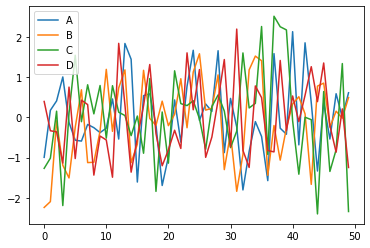

In [4]:
df_1.plot()

In [5]:
df_1.iplot()

## Line PLots

In [34]:
import plotly.graph_objects as go
df_stocks = px.data.stocks()
# px.line(df_stocks, x = 'date', y = 'GOOG')
px.line(df_stocks, x ='date', y= 'GOOG', labels={'date' : 'Date', 'GOOG' : 'Price'}, title='Price value of Goole over the year')

In [39]:
px.line(df_stocks,x = 'date', y = ['GOOG', 'AAPL', 'AMZN', 'FB'], 
        labels = {'date': 'Date'}, title =' Apple vs Google vs Amazon vs FB')

In [49]:
fig = go.Figure()
fig.add_trace(go.Scatter(x= df_stocks['date'], y= df_stocks['GOOG'], name='Alphabet', mode="lines+markers"))
fig.add_trace(go.Scatter(x= df_stocks['date'], y= df_stocks['AAPL'],name='Apple', mode ="lines+markers"))
fig.add_trace(go.Scatter(x= df_stocks['date'], y= df_stocks['AMZN'],name='Amazon', mode ='lines' ))
#updates
#fig.update_layout(title = 'Stock Price Data 2018-2020', xaxis_title= 'Price', yaxis_title = 'Data')
fig.update_layout(xaxis_title= 'Price', yaxis_title = 'Data')

In [80]:
fig.update_layout(
xaxis=dict(showline= True, showgrid=False, showticklabels=True,linecolor= 'rgb(204,204,204)',linewidth=2,ticks='outside',
        tickfont=dict(family='Arial', size=12,color='rgb(82,82,82)')),
    
yaxis = dict(showline= False, showgrid= False, showticklabels= False, zeroline = False),

autosize =False,
margin = dict(autoexpand =False, l = 100, r =20 ,t=110) , 
showlegend = False,
plot_bgcolor ='white'
) 



## Barcharts

In [98]:
df_uk = px.data.gapminder().query("country == 'United Kingdom'")

In [94]:
#df_UK = df_uk[df_uk['country'] == 'United Kingdom']  ## oneway to filter 

In [101]:
px.bar(df_uk, x='year', y='pop')

In [107]:
df_tips =px.data.tips()
px.bar(df_tips, x = 'day',y ='tip', color = 'sex', title = 'Tips by gender on each day',
      labels = {'tip': 'Total tips', 'day': 'Day of the week'})

In [110]:
px.bar(df_tips, x = 'sex',y ='total_bill', color = 'smoker', title = 'Tips by gender on each day',
   barmode ='group')

In [145]:
df_eu = px.data.gapminder().query("continent == 'Europe' and year == '2007' and pop > 2.e6 ")
fig = px.bar(df_eu, x ='country' ,y ='pop', text ='pop',color='country' )
fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.update_layout(uniformtext_minsize=8)
fig.update_layout(xaxis_tickangle = -45)
fig

## scatterplot

In [121]:
df_iris = px.data.iris()

In [124]:
df_iris.columns

Index(['sepal_length', 'sepal_width', 'petal_length', 'petal_width', 'species',
       'species_id'],
      dtype='object')

In [129]:
px.scatter(df_iris, x ='sepal_width', y = 'sepal_length', color = 'species', size ='petal_length', hover_data = ['petal_width'])


In [150]:
fig = go.Figure(go.Scatter(
    x = df_iris['sepal_width'], y = df_iris['sepal_length'] , mode = 'markers', marker_color =  df_iris['sepal_length'],
    text = df_iris['species'], 
    marker = dict(showscale = True), marker_line_width =2, marker_size=10
))
fig.show()

In [164]:
fig = go.Figure(go.Scattergl(
    x = np.random.randn(100000) , y = np.random.randn(100000), mode = 'markers',
    marker = dict(color =np.random.randn(100000),
    colorscale = 'Viridis' , line_width =1 ) #, marker_line_width =2, marker_size=10
))
fig.show()

# Pie Chart

In [175]:
df_asia = px.data.gapminder().query("year == 2007").query("continent == 'Asia'")
px.pie(df_asia, values ='pop', names = 'country', title = 'Population of asian continent', color_discrete_sequence=px.colors.sequential.RdBu)

In [211]:
colors = ['blue','green','black','purple','red','brown']

fig = go.Figure(data = [go.Pie(labels =['water','Grass','Normal','Psychic', 'Fire','Ground'],
                              values = [110,90,80,80,70,60])])

fig.update_traces(hoverinfo = 'label+percent', textfont_size =20, textinfo='label+percent', pull =[0.1,0.1], # pull brings out the obejct from the main pie chart
                 marker = dict(colors = colors, line=dict(color = '#FFFFFF', width =2)  ) )

fig

# Histogram

In [235]:
dice_1 = np.random.randint(1,7,5000)
dice_2 = np.random.randint(1,7,5000)
dice_sum = dice_1 +dice_2

fig = px.histogram(dice_sum, nbins =11, 
                  title ='5000 Dice roll Hostogram',
                  marginal='violin',
                  color_discrete_sequence=['green'])
fig.update_layout(
xaxis_title_text ='Dice Roll' ,
yaxis_title_text ='Dice Sum',
bargap=0.2, showlegend= False
)


fig

In [237]:
df_tips = px.data.tips()
px.histogram(df_tips, x='total_bill',color='sex')

# Boxplot

In [256]:
df_tips.columns

Index(['total_bill', 'tip', 'sex', 'smoker', 'day', 'time', 'size'], dtype='object')

In [259]:
df_tips = px.data.tips()
px.box(df_tips, x ='sex', y = 'tip', points ='all', color = 'sex')

In [265]:
fig = go.Figure(
go.Box( x = df_tips['sex'], y = df_tips['tip'],marker_color = 'blue', boxmean ='sd')
)
fig

In [35]:
## without using .add_trace(), if you need one box of particular field
df_stocks = px.data.stocks()
fig = go.Figure(go.Box(y = df_stocks['GOOG'] , boxpoints='all' , fillcolor= 'blue' , jitter = 0.5 ,
                       whiskerwidth= 0.2,
                       
))


fig

In [38]:
## using .add_trace() method

fig = go.Figure()

fig.add_trace(go.Box(y = df_stocks['GOOG'] , boxpoints='all' , fillcolor= 'blue' , jitter = 0.5 ,whiskerwidth= 0.2, name='Alphabet') )
fig.add_trace(go.Box(y = df_stocks['AAPL'] , boxpoints='all' , fillcolor= 'red' , jitter = 0.5 ,whiskerwidth= 0.2 , name='Apple'))
fig.add_trace(go.Box(y = df_stocks['FB'] , boxpoints='all' , fillcolor= 'Green' , jitter = 0.5 ,whiskerwidth= 0.2, name='Meta'))
fig.update_layout(title = "GOOG vs FB vs AAPL" , )
fig

# violine plot

In [44]:
df_tips = px.data.tips()
px.violin(df_tips, y = 'total_bill', box = True, points ='all')

In [50]:
px.violin(df_tips, y = 'tip',x='smoker', color ='sex', box = True, points ='all', hover_data=df_tips.columns)

# hover_data=df_tips.columns -- > you can see the columns name while hover over the data

In [73]:
fig = go.Figure()
fig.add_trace(go.Violin(x=df_tips['day'][df_tips['smoker'] == 'Yes'], y = df_tips['total_bill'][df_tips['smoker'] == 'Yes'],
                       legendgroup ='Yes', scalegroup ='Yes' , name ='Yes' , line_color='blue' , side ='negative' #left side of the violineplot
                       ))

fig.add_trace(go.Violin(x=df_tips['day'][df_tips['smoker'] == 'No'], y = df_tips['total_bill'][df_tips['smoker'] == 'No'],
                       legendgroup ='Yes', scalegroup ='Yes' , name ='Yes' , line_color='red' , side ='positive' #riht side of the violineplot
                       ))

# Density Heatmaps 

In [77]:
flights = sns.load_dataset('flights')
flights.head(2)

,year,month,passengers
0,1949,Jan,112
1,1949,Feb,118


In [81]:
px.density_heatmap(flights, x ='year',y='month', z= 'passengers'
                  
                  )

In [84]:
px.density_heatmap(flights, x ='year',y='month', z= 'passengers',
                  marginal_x='histogram',
                   marginal_y='histogram'
                  )

# 3D Scatter Plots

In [87]:
flights = sns.load_dataset('flights')
fig = px.scatter_3d(flights, x ='year',y='month', z= 'passengers', color = 'year', opacity = 0.7
)
fig

# 3D line PLots

In [97]:
fig = px.line_3d(flights, x ='year',y='month',z= 'passengers', color = 'year',# opacity = 0.7 ,opacity is not allowed
)
fig

In [92]:
df_stocks.head()

,date,GOOG,AAPL,AMZN,FB,NFLX,MSFT
0,2018-01-01,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,2018-01-08,1.018172,1.011943,1.061881,0.959968,1.053526,1.015988
2,2018-01-15,1.032008,1.019771,1.053240,0.970243,1.049860,1.020524
3,2018-01-22,1.066783,0.980057,1.140676,1.016858,1.307681,1.066561
4,2018-01-29,1.008773,0.917143,1.163374,1.018357,1.273537,1.040708


# Scatter matrix

In [91]:
fig= px.scatter_matrix(flights, color = 'month')
fig

# Map Scatter plot

In [102]:
df = px.data.gapminder().query("year == 2007")
fig = px.scatter_geo(df, locations= 'iso_alpha', color = 'continent', 
                     hover_name= 'country', size ='pop', projection='orthographic')
fig

# Choropleth Maps

In [113]:
# You can color complex maps like we do here representing unemployment data
%time
# Allows us to grab data from a supplied URL
from urllib.request import urlopen
# Used to decode JSON data
import json
# Grab US county geometry data
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

# Grab unemployment data based on each counties Federal Information Processing number
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv",
                   dtype={"fips": str})

# Draw map using the county JSON data, color using unemployment values on a range of 12
fig = px.choropleth(df, geojson=counties, locations='fips', color='unemp',
                           color_continuous_scale="Viridis",
                           range_color=(0, 12),
                           scope="usa",
                           labels={'unemp':'unemployment rate'}
                          )
fig


Wall time: 0 ns


# Polar Chart

In [114]:
df_wind = px.data.wind()
px.scatter_polar(df_wind, r="frequency", theta="direction", color="strength",
                size="frequency", symbol="strength")



In [115]:
# Data can also be plotted using lines radially
# A template makes the data easier to see
px.line_polar(df_wind, r="frequency", theta="direction", color="strength",
                line_close=True, template="plotly_dark", width=800, height=400)

# Ternary Plot

In [116]:
# Used to represent ratios of 3 variables
df_exp = px.data.experiment()
px.scatter_ternary(df_exp, a="experiment_1", b="experiment_2", 
                   c='experiment_3', hover_name="group", color="gender")

# Facets

In [117]:
df_tips = px.data.tips()
px.scatter(df_tips, x="total_bill", y="tip", color="smoker", facet_col="sex")

In [118]:
# We can line up data in rows and columns
px.histogram(df_tips, x="total_bill", y="tip", color="sex", facet_row="time", facet_col="day",
       category_orders={"day": ["Thur", "Fri", "Sat", "Sun"], "time": ["Lunch", "Dinner"]})

In [121]:
att_df

,Unnamed: 0,subject,attention,solutions,score
0,0,1,divided,1,2.0
1,1,2,divided,1,3.0
2,2,3,divided,1,3.0
3,3,4,divided,1,5.0
4,4,5,divided,1,4.0
5,5,6,divided,1,5.0
6,6,7,divided,1,5.0
7,7,8,divided,1,5.0
8,8,9,divided,1,2.0
9,9,10,divided,1,6.0


In [119]:
att_df = sns.load_dataset("attention")
fig = px.line(att_df, x='solutions', y='score', facet_col='subject',
             facet_col_wrap=5, title='Scores Based on Attention')
fig
#facet_col_wrap= --> 

# Animated Plots

In [248]:
df_cnt = px.data.gapminder()
px.scatter(df_cnt, x ="gdpPercap", y = 'lifeExp',
          animation_frame='year',
          animation_group= 'country',
          size ='pop', color= 'continent', hover_name = 'country',
         size_max =55, range_x=[100,100000], range_y = [25,90]
          )

In [253]:
px.bar(df_cnt, x ="continent", y = 'pop', color='continent',
          animation_frame='year',
          animation_group= 'country', range_y =[0,4000000000] )